In [1]:
# plotly standard imports
import plotly.graph_objs as go
import chart_studio.plotly as py

# Cufflinks wrapper on plotly
import cufflinks

# Data science imports
import pandas as pd
import numpy as np

# Options for pandas
pd.options.display.max_columns = 30

# Display all cell outputs
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = 'all'

from plotly.offline import iplot, init_notebook_mode
cufflinks.go_offline(connected=True)
init_notebook_mode(connected=True)

# Set global theme
cufflinks.set_config_file(world_readable=True, theme='pearl')

# Load dataset
And get interesting features

In [2]:
from src.load_datasets import load_datasets
from src.prepare_datasets import feature_list

train, test = load_datasets()

train_features = train[feature_list]
test_features = test[feature_list]

train_features.index = pd.to_datetime(train.pop('timestamp'), unit='ms')
test_features.index = pd.to_datetime(test.pop('timestamp'), unit='ms')

train_features

,high,low,open,close,volume
timestamp,,,,,
2016-08-10 15:53:00,579.000000,579.00,579.00,579.000000,1.000000
2016-08-10 15:54:00,604.750000,592.96,592.96,604.750000,131.838200
2016-08-10 15:55:00,604.750000,600.00,604.75,600.000000,89.437926
2016-08-10 15:57:00,604.750000,600.00,600.00,604.750000,51.328200
2016-08-10 15:58:00,604.750000,604.75,604.75,604.750000,4.586500
...,...,...,...,...,...
2020-04-22 12:37:00,6946.000000,6945.00,6945.90,6946.000000,0.130838
2020-04-22 12:38:00,6948.700000,6946.00,6946.00,6948.684645,0.951414
2020-04-22 12:39:00,6951.300000,6947.10,6948.70,6950.100000,0.055320


# Data featuring

In theory we are going to use 4 features: The price itself and three extra technical indicators.

MACD (Trend)
Stochastics (Momentum)
Average True Range (Volume)

## Functions

**Exponential Moving Average**: Is a type of infinite impulse response filter that applies weighting factors which decrease exponentially. The weighting for each older datum decreases exponentially, never reaching zero.

**MACD**: The Moving Average Convergence/Divergence oscillator (MACD) is one of the simplest and most effective momentum indicators available. The MACD turns two trend-following indicators, moving averages, into a momentum oscillator by subtracting the longer moving average from the shorter moving average.

**Stochastics oscillator**: The Stochastic Oscillator is a momentum indicator that shows the location of the close relative to the high-low range over a set number of periods.

**Average True Range**: Is an indicator to measure the volalitility (NOT price direction). The largest of:

- Method A: Current High less the current Low
- Method B: Current High less the previous Close (absolute value)
- Method C: Current Low less the previous Close (absolute value)

In [3]:
from src.indicators import MACD, stochastics_oscillator, ATR

In [4]:
days_to_show = 60
items_to_show = days_to_show * 24 * 60

## MACD

In [5]:
macd = MACD(train_features['close'][-items_to_show:], 12, 26, 9)

pd.DataFrame({'MACD': macd}).iplot()

## Stochastics Oscillator

In [6]:
stochastics = stochastics_oscillator(train_features['close'][-items_to_show:], 14)

pd.DataFrame({'Stochastics Oscillator': stochastics}).iplot()

## Average True Range

In [7]:
atr = ATR(train_features.iloc[-items_to_show:], 14)

atr.head()

atr.iplot()

,0
timestamp,
2020-02-22 03:08:00,0.012297
2020-02-22 03:09:00,0.100000
2020-02-22 03:10:00,0.012297
2020-02-22 03:11:00,0.100000
2020-02-22 03:12:00,0.100000


## Check for normal distribution

timestamp
2016-08-10 15:54:00    0.044473
2016-08-10 15:55:00   -0.007854
2016-08-10 15:57:00    0.007917
2016-08-10 15:58:00    0.000000
2016-08-10 15:59:00    0.000000
Name: close, dtype: float64

((array([-4.94453614, -4.76886449, -4.67400546, ...,  4.67400546,
          4.76886449,  4.94453614]),
  array([-0.17508113, -0.12714831, -0.0479099 , ...,  0.06530612,
          0.06600338,  0.12148934])),
 (0.00107797240830823, 2.207475798096329e-06, 0.8328053817597639))

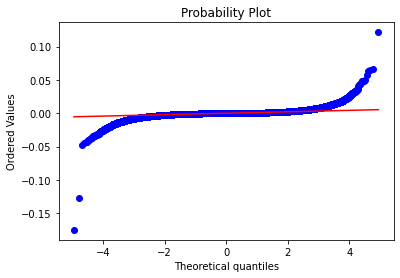

In [8]:
import scipy.stats as stats
import pylab

close_change = train_features['close'].pct_change()[1:]
close_change.head()

stats.probplot(close_change, dist='norm', plot=pylab)

### Check time relation

Check depenence of trading and price from date in year and time of day

#### Firstly define function for display frequiency

In [9]:
import tensorflow as tf
import matplotlib.pyplot as plt

def plot_log_freaquency(series):
    fft = tf.signal.rfft(series)    
    f_per_dataset = np.arange(0, len(fft))

    n_samples_d = len(series)
    days_per_year = 365
    years_per_dataset = n_samples_d/(days_per_year)

    f_per_year = f_per_dataset/years_per_dataset
    plt.step(f_per_year, np.abs(fft))
    plt.xscale('log')
    plt.xticks([1, 365], labels=['1/Year', '1/day'])
    _ = plt.xlabel('Frequency (log scale)')

### Frequency of price

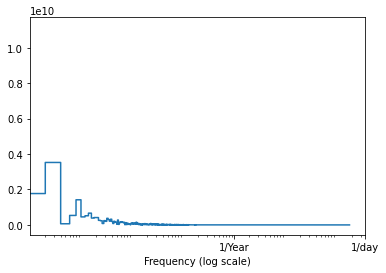

In [10]:
plot_log_freaquency(train_features['close'])

### Frequence of price change

In [ ]:
plot_log_freaquency(train_features['close'].diff().dropna())

### Frequency of transaction volume

In [ ]:
plot_log_freaquency(train_features['volume'])

### Frequence of transaction volume change 

In [ ]:
plot_log_freaquency(train_features['volume'].diff().dropna())

## Compare train and test datasets

In [ ]:
import sweetviz as sv

compare_report = sv.compare([train_features, 'Train data'], [test_features, 'Test data'], "close")
compare_report.show_notebook()

### Training data exploration

In [ ]:
train_features[59::60].iplot(subplots=True)

### Testing data exploration

In [ ]:
test_features[59::60].iplot(subplots=True)

## Normalise data

Will use only training mean and deviation for not give NN access to test dataset
 
Divide by the max-min deviation


In [ ]:
pd.set_option('float_format', '{:.2f}'.format)

train_features.describe()

In [ ]:
test_features.describe()

In [ ]:
train_mean = train_features.mean()
train_max = train_features.max()
train_min = train_features.min()
train_std = train_features.std()

maximum for training to litle, and not will allow correctly predict values in testing dataset,
will use manually choosed value for maximum
100 thouthands dollars
except of volume

In [ ]:
MAX_TARGET = 100000
train_max['high'] = MAX_TARGET
train_max['low'] = MAX_TARGET
train_max['open'] = MAX_TARGET
train_max['close'] = MAX_TARGET

In [ ]:
train_d = train_max - train_min

train_normalised = train_features / train_d
test_normalised = test_features / train_d

train_normalised.head()

In [ ]:
train_normalised.index = train_features.index
train_normalised[59::60].iplot(subplots=True, title="Train")

test_normalised.index = test_features.index
test_normalised[59::60].iplot(subplots=True, title="Test")

In [ ]:
train_in_hours = train_features[59::60]

feature2normaliesd = pd.DataFrame({ 
    'Real': train_in_hours['close'], 
    'Normalised': train_normalised['close'][59::60]
})
feature2normaliesd.index = train_in_hours.index

feature2normaliesd.iplot(subplots=True)